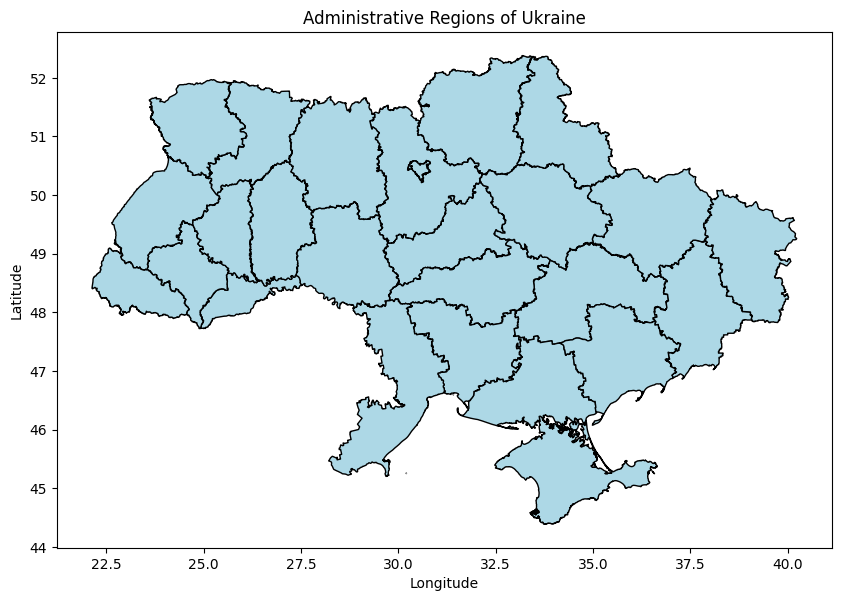

In [1]:
import geopandas as gpd
import matplotlib.pyplot as plt

shp_path = r"C:\Users\Charlie\Downloads\ukr_admbnd_sspe_20240416_ab_shp"
shp_file = r"ukr_admbnda_adm0_sspe_20240416.shp"
shp_file = r"ukr_admbnda_adm1_sspe_20240416.shp"
# shp_file = r"ukr_admbnda_adm2_sspe_20240416.shp"
# shp_file = r"ukr_admbnda_adm3_sspe_20240416.shp"
# shp_file = r"ukr_admbnda_adm4_sspe_20240416.shp"
# shp_file = r"ukr_admbndp_adm0123_sspe_itos_20240416.shp"

# Load the shapefile
ukraine_regions = gpd.read_file(f"{shp_path}\{shp_file}")

# Plot the regions
ukraine_regions.plot(figsize=(10, 10), edgecolor='black', facecolor='lightblue')
plt.title("Administrative Regions of Ukraine")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.show()

In [82]:
import pandas as pd
import geopandas as gpd
from bokeh.io import output_notebook, show
from bokeh.plotting import figure
from bokeh.models import GeoJSONDataSource, HoverTool
from bokeh.palettes import Magma, Inferno, Plasma, Viridis, Cividis, Reds5, Reds256
from bokeh.io import output_file, save
from bokeh.models import ColumnDataSource, HoverTool, ColorBar, FixedTicker
from bokeh.transform import linear_cmap
from bokeh.palettes import Viridis256
from bokeh.io import export_png

output_notebook()


Loading BokehJS ...

In [83]:
hdx_file = r"ukr-2024-hnrp-pin-severity-targets-activities-20240119.xlsx"

hdx_data = pd.read_excel(hdx_file,sheet_name="Overall PiN, Severity & Target",skiprows=3)

In [84]:
hdx_data["ADM2_PCODE"]=hdx_data["adm2_pcode"]

In [85]:
shp_path = r"C:\Users\Charlie\Downloads\ukr_admbnd_sspe_20240416_ab_shp"
shp_file_obl = r"ukr_admbnda_adm1_sspe_20240416.shp"
shp_file_rai = r"ukr_admbnda_adm2_sspe_20240416.shp"

In [86]:
# Load the shapefile with GeoPandas
gdf = gpd.read_file(f"{shp_path}\{shp_file_rai}")

In [87]:
hdx_gdf = gdf.merge(hdx_data,on=['ADM2_PCODE'],how="left")


In [88]:
# Convert GeoDataFrame to GeoJSON format and use GeoJSONDataSource
geo_source = GeoJSONDataSource(geojson=hdx_gdf.to_json())

In [93]:
# Create a Bokeh figure
p = figure(title="Ukraine - HDX Humanitarian Severity of Need", toolbar_location="right",
           tools="pan,wheel_zoom,reset", active_scroll="wheel_zoom",
           width=600, height=400,
           )
p.grid.grid_line_color = None

# Add patches to display regions
patches_renderer  = p.patches('xs', 'ys', source=geo_source, fill_color="white",
          line_color="black", line_width=0.5, fill_alpha=0.7,line_alpha=1.0)

# Define a color mapper based on 'value'
color_mapper = linear_cmap(field_name='overall_sev_int', palette=Reds5, low=hdx_gdf["overall_sev_int"].max(), high=hdx_gdf["overall_sev_int"].min())
color_mapper = linear_cmap(field_name='overall_sev_int', palette=Reds5, low=5, high=0)
# color_mapper = linear_cmap(field_name='overall_pin_joint', palette=Reds256, low=hdx_gdf["overall_pin_joint"].max(), high=0)

# Add patches with color mapping based on 'value'
patches_renderer = p.patches(xs='xs', ys='ys', source=geo_source, fill_color=color_mapper, line_color="black")

# # URL of the Ukrainian flag (you can replace this with a local path or a different URL)
flag_url = "Flag_of_Ukraine.jpg"

p.x_range.start = 21
p.x_range.end = 41
p.y_range.start = 44
p.y_range.end = 53

# Add the flag as a background image to fill the plot area
p.image_url(url=[flag_url], x=p.x_range.start, y=p.y_range.end, w=p.x_range.end - p.x_range.start,
            h=p.y_range.end - p.y_range.start, anchor="top_left",level="underlay",
            alpha=1.0)

# Add HoverTool to display the name of the region
hover = HoverTool(renderers=[patches_renderer])
hover.tooltips = [('People in need','@overall_pin_joint{0,0}'),
                  ('Severity of need','@overall_sev_int{0,0}'),
                  ('Oblast_en','@ADM1_EN'),
                  ('Oblast_ua','@ADM1_UA'),
                  ('Raion_en','@ADM2_EN'),
                  ('Raion_ua','@ADM2_UA'),
                  ('Code','@ADM2_PCODE'),
                  ('Area (sqkm)','@AREA_SQKM{0,0}'),
                    ]

p.add_tools(hover)

# Define specific tick locations for the color bar
custom_ticks = [0,1,2,3,4,5]  # Define custom tick positions
ticker = FixedTicker(ticks=custom_ticks)

# Add a color bar to indicate the range of values
color_bar = ColorBar(color_mapper=color_mapper['transform'], ticker=ticker, width=8, location=(0,0))
# color_bar = ColorBar(color_mapper=color_mapper['transform'], width=8, location=(0,0))
p.add_layout(color_bar, 'left')


In [94]:
export_png(p, filename=f"2408-HDX.png")
output_file("2408-HDX.html")
show(p)

In [ ]:
# output_notebook()

# # Specify the output HTML file
# output_file("2408-HDX.html")

# shp_path = r"C:\Users\Charlie\Downloads\ukr_admbnd_sspe_20240416_ab_shp"
# shp_file_obl = r"ukr_admbnda_adm1_sspe_20240416.shp"
# shp_file_rai = r"ukr_admbnda_adm2_sspe_20240416.shp"
# #shp_file_hrom = r"ukr_admbnda_adm3_sspe_20240416.shp"

# # Load the shapefile with GeoPandas
# gdf = gpd.read_file(f"{shp_path}\{shp_file_rai}")

# color_map = {}
# for cnt,oblast in enumerate(set(gdf["ADM1_EN"])):
#     color_map[oblast] = Viridis[256][int(cnt*256/27)]

# gdf["fill_color"] = gdf["ADM1_EN"].map(color_map)

# # Convert GeoDataFrame to GeoJSON format and use GeoJSONDataSource
# geo_source = GeoJSONDataSource(geojson=gdf.to_json())

# # Load the shapefile with GeoPandas
# gdf = gpd.read_file(f"{shp_path}\{shp_file_rai}")

# # Convert GeoDataFrame to GeoJSON format and use GeoJSONDataSource
# geo_source_rai = GeoJSONDataSource(geojson=gdf.to_json())

# # Load the shapefile with GeoPandas
# gdf = gpd.read_file(f"{shp_path}\{shp_file_obl}")

# # Convert GeoDataFrame to GeoJSON format and use GeoJSONDataSource
# geo_source_obl = GeoJSONDataSource(geojson=gdf.to_json())

# # Create a Bokeh figure
# p = figure(title="Ukraine - Subnational Administrative Boundaries", toolbar_location="right",
#            tools="pan,wheel_zoom,reset", active_scroll="wheel_zoom",
#            width=600, height=400,
#            )
# p.grid.grid_line_color = None

# # Add patches to display regions
# patches_renderer  = p.patches('xs', 'ys', source=geo_source, fill_color="white",
#           line_color="black", line_width=0.5, fill_alpha=0.7,line_alpha=1.0)

# # Add HoverTool to display the name of the region
# hover = HoverTool(renderers=[patches_renderer])
# hover.tooltips = [#('Country_en','@ADM0_EN'),
#                   #('Country_ua','@ADM0_UA'),
#                   # ('Country_ru','@ADM0_RU'),
#                   #('Country_code','@ADM0_PCODE'), 
#                   ('Oblast_en','@ADM1_EN'),
#                   ('Oblast_ua','@ADM1_UA'),
#                   # ('Oblast_ru','@ADM1_RU'),
#                   #('Oblast_code','@ADM1_PCODE'),
#                   ('Raion_en','@ADM2_EN'),
#                   ('Raion_ua','@ADM2_UA'),
#                   # ('Raion_ru','@ADM2_RU'),
#                   # ('Raion_code','@ADM2_PCODE'),
#                   # ('Hromadas_en','@ADM3_EN'),
#                   # ('Hromadas_ua','@ADM3_UA'),
#                   # ('Hromadas_ru','@ADM2_RU'),
#                   ('Code','@ADM2_PCODE'),
#                   ('Area (sqkm)','@AREA_SQKM{0,0}'),
#                     ]

# p.add_tools(hover)


# p.multi_line('xs', 'ys', source=geo_source_rai,
#           line_color="yellow", line_width=0.75,line_alpha=1.0)

# p.multi_line('xs', 'ys', source=geo_source_obl,
#           line_color="blue", line_width=1,line_alpha=1.0)



# # URL of the Ukrainian flag (you can replace this with a local path or a different URL)
# flag_url = "Flag_of_Ukraine.jpg"

# p.x_range.start = 21
# p.x_range.end = 41
# p.y_range.start = 44
# p.y_range.end = 53

# # Add the flag as a background image to fill the plot area
# p.image_url(url=[flag_url], x=p.x_range.start, y=p.y_range.end, w=p.x_range.end - p.x_range.start,
#             h=p.y_range.end - p.y_range.start, anchor="top_left",level="underlay",
#             alpha=1.0)

# # Show plot
# show(p)
